# IoT Anomaly Detection - Data Exploration

The purpose of this notebook is to explore and visualize the data I'm going to use for the IoT anomaly detection project.

<u><b>DataSet description:</b></u>
1. Title of the database: "N-BaIoT: Data for network based detection of IoT botnet attacks"

2. Source Information
   -- Creators: Yair Meidan, Michael Bohadana, Yael Mathov, Yisroel Mirsky, Dominik Breitenbacher, Asaf Shabtai and Yuval Elovici
     -- Meidan, Bohadana, Mathov, Mirsky, Shabtai: Department of Software and Information Systems Engineering; Ben-Gurion University of the Negev; Beer-Sheva, 8410501; Israel
	 -- Breitenbacher, Elovici: iTrust Centre of Cybersecurity at Singapore University of Technology and Design; 8 Somapah Rd, Singapore 487372
   -- Donor: Yair Meidan (yairme@bgu.ac.il)
   -- Date: March, 2018 (databases may change over time without name change!)
 
3. Past Usage:
    (a) Please cite the following papers:
		-- Reference to the article where it was initially described and used:
			-- Y. Meidan, M. Bohadana, Y. Mathov, Y. Mirsky, D. Breitenbacher, A. Shabtai, and Y. Elovici "N-BaIoT: Network-based Detection of IoT Botnet Attacks Using Deep Autoencoders", IEEE Pervasive Computing, Special Issue - Securing the IoT (July/Sep 2018).
		-- Reference to the article where the feature extractor (from *.pcap to *.csv) was described: 
			-- Y. Mirsky, T. Doitshman, Y. Elovici & A. Shabtai 2018, "Kitsune: An Ensemble of Autoencoders for Online Network Intrusion Detection", in Network and Distributed System Security (NDSS) Symposium, San Diego, CA, USA.				
	(b) Attribute being predicted:
		-- Originally we aimed at distinguishing between benign and Malicious traffic data by means of anomaly detection techniques.
		-- However, as the malicious data can be divided into 10 attacks carried by 2 botnets, the dataset can also be used for multi-class classification: 10 classes of attacks, plus 1 class of "benign".
	(c) The study's results:
		-- For each of the 9 IoT devices we trained and optimized a deep autoencoder on 2/3 of its benign data (i.e., the training set of each device). This was done to capture normal network traffic patterns.
        -- The test data of each device comprised of the remaining 1/3 of benign data plus all the malicious data. On each test set we applied the respective trained (deep) autoencoder as an anomaly detector. The detection of anomalies (i.e., the cyberattacks launched from each of the above IoT devices) concluded with 100% TPR.  
	      
4. Relevant Information:
   -- This dataset addresses the lack of public botnet datasets, especially for the IoT.
   -- Prior experimental studies on the detection of IoT botnets or IoT traffic anomalies typically relied on emulated or simulated data. In contrary , this dataset enables empirical evaluation with *real* traffic data, gathered from nine commercial IoT devices infected by authentic botnets from two families in an isolated network. It facilitates the examination of Mirai and BASHLITE, two of the most common IoT-based botnets, which have already demonstrated their harmful capabilities.

5. Number of Instances: Varies for every device and attack. 

6. Number of Attributes: 115 independent features in each file, plus a class label to be derived from the respective filename (e.g., "benign" or "TCP attack").

7. Attribute Information:
	-- The following describes each of the features headers:
		-- Stream aggregation:
			H: ("Source IP" in N-BaIoT paper) Stats summarizing the recent traffic from this packet's host (IP)
			MI: ("Source MAC-IP" in N-BaIoT paper) Stats summarizing the recent traffic from this packet's host (IP + MAC)
			HH: ("Channel" in N-BaIoT paper) Stats summarizing the recent traffic going from this packet's host (IP) to the packet's destination host.
			HH_jit: ("Channel jitter" in N-BaIoT paper) Stats summarizing the jitter of the traffic going from this packet's host (IP) to the packet's destination host.
			HpHp: ("Socket" in N-BaIoT paper) Stats summarizing the recent traffic going from this packet's host+port (IP) to the packet's destination host+port. Example 192.168.4.2:1242 -> 192.168.4.12:80
		-- Time-frame (The decay factor Lambda used in the damped window): 
			-- How much recent history of the stream is capture in these statistics
			-- L5, L3, L1, L0.1 and L0.01 (100ms, 500ms, 1.5sec, 10sec, 1min)
		-- The statistics extracted from the packet stream:
			weight: The weight of the stream (can be viewed as the number of items observed in recent history)
			mean: ...
			std: ...
			radius: The root squared sum of the two streams' variances
			magnitude: The root squared sum of the two streams' means 
			cov: An approximated covariance between two streams
			pcc: An approximated correlation coefficient between two streams

## References
1. The dataset - “detection of IoT botnet attacks N BaIoT” https://archive.ics.uci.edu/ml/datasets/detection_of_IoT_botnet_attacks_N_BaIoT
2. Yair Meidan, Michael Bohadana, Yael Mathov, Yisroel Mirsky, Dominik Breitenbacher, Asaf Shabtai, and Yuval Elovici, “N-BaIoT: Network-based Detection of IoT Botnet Attacks Using Deep Autoencoders". https://arxiv.org/pdf/1805.03409.pdf
3. Pankaj Malhotra, Anusha Ramakrishnan, Gaurangi Anand, Lovekesh Vig, Puneet Agarwal, Gautam Shroff, "LSTM-based Encoder-Decoder for Multi-sensor Anomaly Detection". https://arxiv.org/pdf/1607.00148.pdf
4. Yisroel Mirsky, Tomer Doitshman, Yuval Elovici and Asaf Shabtai, "Kitsune: An Ensemble of Autoencoders for Online Network Intrusion Detection". https://arxiv.org/pdf/1802.09089.pdf

In [1]:
# imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [28]:
# dataset constants
PROJECT_PATH              = "../"  # TODO change when migrating this notbook
DATA_PATH                 = PROJECT_PATH + "data/"
DANMINI_DOORBELL_DIR      = DATA_PATH + "Danmini_Doorbell/"
ENNIO_DOORBELL_DIR        = DATA_PATH + "Ennio_Doorbell/"
ECOBEE_THERMOSTAT_DIR     = DATA_PATH + "Ecobee_Thermostat/"
PHILIPS_BABY_MONITOR_DIR  = DATA_PATH + "Philips_B120N10_Baby_Monitor/"
PROV_737_SECURITY_CAM_DIR = DATA_PATH + "Provision_PT_737E_Security_Camera/"
PROV_838_SECURITY_CAM_DIR = DATA_PATH + "Provision_PT_838_Security_Camera/"
SAMSUNG_WEB_CAM_DIR       = DATA_PATH + "Samsung_SNH_1011_N_Webcam/"
SH_1002_SECURITY_CAM_DIR  = DATA_PATH + "SimpleHome_XCS7_1002_WHT_Security_Camera/"
SH_1003_SECURITY_CAM_DIR  = DATA_PATH + "SimpleHome_XCS7_1003_WHT_Security_Camera/"

BENIGN_TRAFFIC_FILE  = "benign_traffic.csv"
GAFGYT_ATTACKS_DIR   = "gafgyt_attacks/"
GAFGYT_COMBO_FILE    = GAFGYT_ATTACKS_DIR + "combo.zip"
GAFGYT_JUNK_FILE     = GAFGYT_ATTACKS_DIR + "junk.zip"
GAFGYT_SCAN_FILE     = GAFGYT_ATTACKS_DIR + "scan.zip"
GAFGYT_TCP_FILE      = GAFGYT_ATTACKS_DIR + "tcp.zip"
GAFGYT_UDP_FILE      = GAFGYT_ATTACKS_DIR + "udp.zip"
MIRAI_ATTACKS_DIR    = "mirai_attacks/"
MIRAI_ACK_FILE       = MIRAI_ATTACKS_DIR + "ack.zip"
MIRAI_SCAN_FILE      = MIRAI_ATTACKS_DIR + "scan.zip"
MIRAI_SYN_FILE       = MIRAI_ATTACKS_DIR + "syn.zip"
MIRAI_UDP_FILE       = MIRAI_ATTACKS_DIR + "udp.zip"
MIRAI_UDPPLAIN_FILE  = MIRAI_ATTACKS_DIR + "udpplain.zip"

# df cols
src_mac_ip_L5_weight             = 'src_mac_ip_L5_weight'
src_mac_ip_L5_mean               = 'src_mac_ip_L5_mean'
src_mac_ip_L5_variance           = 'src_mac_ip_L5_variance'
src_mac_ip_L3_weight             = 'src_mac_ip_L3_weight'
src_mac_ip_L3_mean               = 'src_mac_ip_L3_mean'
src_mac_ip_L3_variance           = 'src_mac_ip_L3_variance'
src_mac_ip_L1_weight             = 'src_mac_ip_L1_weight'
src_mac_ip_L1_mean               = 'src_mac_ip_L1_mean'
src_mac_ip_L1_variance           = 'src_mac_ip_L1_variance'
src_mac_ip_L0_1_weight           = 'src_mac_ip_L0.1_weight'
src_mac_ip_L0_1_mean             = 'src_mac_ip_L0.1_mean'
src_mac_ip_L0_1_variance         = 'src_mac_ip_L0.1_variance'
src_mac_ip_L0_01_weight          = 'src_mac_ip_L0.01_weight'
src_mac_ip_L0_01_mean            = 'src_mac_ip_L0.01_mean'
src_mac_ip_L0_01_variance        = 'src_mac_ip_L0.01_variance'
src_ip_L5_weight                 = 'src_ip_L5_weight'
src_ip_L5_mean                   = 'src_ip_L5_mean'
src_ip_L5_variance               = 'src_ip_L5_variance'
src_ip_L3_weight                 = 'src_ip_L3_weight'
src_ip_L3_mean                   = 'src_ip_L3_mean'
src_ip_L3_variance               = 'src_ip_L3_variance'
src_ip_L1_weight                 = 'src_ip_L1_weight'
src_ip_L1_mean                   = 'src_ip_L1_mean'
src_ip_L1_variance               = 'src_ip_L1_variance'
src_ip_L0_1_weight               = 'src_ip_L0.1_weight'
src_ip_L0_1_mean                 = 'src_ip_L0.1_mean'
src_ip_L0_1_variance             = 'src_ip_L0.1_variance'
src_ip_L0_01_weight              = 'src_ip_L0.01_weight'
src_ip_L0_01_mean                = 'src_ip_L0.01_mean'
src_ip_L0_01_variance            = 'src_ip_L0.01_variance'
src_dst_ip_L5_weight             = 'src_dst_ip_L5_weight'
src_dst_ip_L5_mean               = 'src_dst_ip_L5_mean'
src_dst_ip_L5_std                = 'src_dst_ip_L5_std'
src_dst_ip_L5_magnitude          = 'src_dst_ip_L5_magnitude'
src_dst_ip_L5_radius             = 'src_dst_ip_L5_radius'
src_dst_ip_L5_covariance         = 'src_dst_ip_L5_covariance'
src_dst_ip_L5_pcc                = 'src_dst_ip_L5_pcc'
src_dst_ip_L3_weight             = 'src_dst_ip_L3_weight'
src_dst_ip_L3_mean               = 'src_dst_ip_L3_mean'
src_dst_ip_L3_std                = 'src_dst_ip_L3_std'
src_dst_ip_L3_magnitude          = 'src_dst_ip_L3_magnitude'
src_dst_ip_L3_radius             = 'src_dst_ip_L3_radius'
src_dst_ip_L3_covariance         = 'src_dst_ip_L3_covariance'
src_dst_ip_L3_pcc                = 'src_dst_ip_L3_pcc'
src_dst_ip_L1_weight             = 'src_dst_ip_L1_weight'
src_dst_ip_L1_mean               = 'src_dst_ip_L1_mean'
src_dst_ip_L1_std                = 'src_dst_ip_L1_std'
src_dst_ip_L1_magnitude          = 'src_dst_ip_L1_magnitude'
src_dst_ip_L1_radius             = 'src_dst_ip_L1_radius'
src_dst_ip_L1_covariance         = 'src_dst_ip_L1_covariance'
src_dst_ip_L1_pcc                = 'src_dst_ip_L1_pcc'
src_dst_ip_L0_1_weight           = 'src_dst_ip_L0.1_weight'
src_dst_ip_L0_1_mean             = 'src_dst_ip_L0.1_mean'
src_dst_ip_L0_1_std              = 'src_dst_ip_L0.1_std'
src_dst_ip_L0_1_magnitude        = 'src_dst_ip_L0.1_magnitude'
src_dst_ip_L0_1_radius           = 'src_dst_ip_L0.1_radius'
src_dst_ip_L0_1_covariance       = 'src_dst_ip_L0.1_covariance'
src_dst_ip_L0_1_pcc              = 'src_dst_ip_L0.1_pcc'
src_dst_ip_L0_01_weight          = 'src_dst_ip_L0.01_weight'
src_dst_ip_L0_01_mean            = 'src_dst_ip_L0.01_mean'
src_dst_ip_L0_01_std             = 'src_dst_ip_L0.01_std'
src_dst_ip_L0_01_magnitude       = 'src_dst_ip_L0.01_magnitude'
src_dst_ip_L0_01_radius          = 'src_dst_ip_L0.01_radius'
src_dst_ip_L0_01_covariance      = 'src_dst_ip_L0.01_covariance'
src_dst_ip_L0_01_pcc             = 'src_dst_ip_L0.01_pcc'
src_dst_ip_jit_L5_weight         = 'src_dst_ip_jit_L5_weight'
src_dst_ip_jit_L5_mean           = 'src_dst_ip_jit_L5_mean'
src_dst_ip_jit_L5_variance       = 'src_dst_ip_jit_L5_variance'
src_dst_ip_jit_L3_weight         = 'src_dst_ip_jit_L3_weight'
src_dst_ip_jit_L3_mean           = 'src_dst_ip_jit_L3_mean'
src_dst_ip_jit_L3_variance       = 'src_dst_ip_jit_L3_variance'
src_dst_ip_jit_L1_weight         = 'src_dst_ip_jit_L1_weight'
src_dst_ip_jit_L1_mean           = 'src_dst_ip_jit_L1_mean'
src_dst_ip_jit_L1_variance       = 'src_dst_ip_jit_L1_variance'
src_dst_ip_jit_L0_1_weight       = 'src_dst_ip_jit_L0.1_weight'
src_dst_ip_jit_L0_1_mean         = 'src_dst_ip_jit_L0.1_mean'
src_dst_ip_jit_L0_1_variance     = 'src_dst_ip_jit_L0.1_variance'
src_dst_ip_jit_L0_01_weight      = 'src_dst_ip_jit_L0.01_weight'
src_dst_ip_jit_L0_01_mean        = 'src_dst_ip_jit_L0.01_mean'
src_dst_ip_jit_L0_01_variance    = 'src_dst_ip_jit_L0.01_variance'
src_dst_ip_port_L5_weight        = 'src_dst_ip_port_L5_weight'
src_dst_ip_port_L5_mean          = 'src_dst_ip_port_L5_mean'
src_dst_ip_port_L5_std           = 'src_dst_ip_port_L5_std'
src_dst_ip_port_L5_magnitude     = 'src_dst_ip_port_L5_magnitude'
src_dst_ip_port_L5_radius        = 'src_dst_ip_port_L5_radius'
src_dst_ip_port_L5_covariance    = 'src_dst_ip_port_L5_covariance'
src_dst_ip_port_L5_pcc           = 'src_dst_ip_port_L5_pcc'
src_dst_ip_port_L3_weight        = 'src_dst_ip_port_L3_weight'
src_dst_ip_port_L3_mean          = 'src_dst_ip_port_L3_mean'
src_dst_ip_port_L3_std           = 'src_dst_ip_port_L3_std'
src_dst_ip_port_L3_magnitude     = 'src_dst_ip_port_L3_magnitude'
src_dst_ip_port_L3_radius        = 'src_dst_ip_port_L3_radius'
src_dst_ip_port_L3_covariance    = 'src_dst_ip_port_L3_covariance'
src_dst_ip_port_L3_pcc           = 'src_dst_ip_port_L3_pcc'
src_dst_ip_port_L1_weight        = 'src_dst_ip_port_L1_weight'
src_dst_ip_port_L1_mean          = 'src_dst_ip_port_L1_mean'
src_dst_ip_port_L1_std           = 'src_dst_ip_port_L1_std'
src_dst_ip_port_L1_magnitude     = 'src_dst_ip_port_L1_magnitude'
src_dst_ip_port_L1_radius        = 'src_dst_ip_port_L1_radius'
src_dst_ip_port_L1_covariance    = 'src_dst_ip_port_L1_covariance'
src_dst_ip_port_L1_pcc           = 'src_dst_ip_port_L1_pcc'
src_dst_ip_port_L0_1_weight      = 'src_dst_ip_port_L0.1_weight'
src_dst_ip_port_L0_1_mean        = 'src_dst_ip_port_L0.1_mean'
src_dst_ip_port_L0_1_std         = 'src_dst_ip_port_L0.1_std'
src_dst_ip_port_L0_1_magnitude   = 'src_dst_ip_port_L0.1_magnitude'
src_dst_ip_port_L0_1_radius      = 'src_dst_ip_port_L0.1_radius'
src_dst_ip_port_L0_1_covariance  = 'src_dst_ip_port_L0.1_covariance'
src_dst_ip_port_L0_1_pcc         = 'src_dst_ip_port_L0.1_pcc'
src_dst_ip_port_L0_01_weight     = 'src_dst_ip_port_L0.01_weight'
src_dst_ip_port_L0_01_mean       = 'src_dst_ip_port_L0.01_mean'
src_dst_ip_port_L0_01_std        = 'src_dst_ip_port_L0.01_std'
src_dst_ip_port_L0_01_magnitude  = 'src_dst_ip_port_L0.01_magnitude'
src_dst_ip_port_L0_01_radius     = 'src_dst_ip_port_L0.01_radius'
src_dst_ip_port_L0_01_covariance = 'src_dst_ip_port_L0.01_covariance'
src_dst_ip_port_L0_01_pcc        = 'src_dst_ip_port_L0.01_pcc'


### Load Damini doorbell data

In [3]:
# load damini doorbell data
df_damini_doorbell_benign         = pd.read_csv(DANMINI_DOORBELL_DIR + BENIGN_TRAFFIC_FILE)
df_damini_doorbell_gafgyt_combo   = pd.read_csv(DANMINI_DOORBELL_DIR + GAFGYT_COMBO_FILE)
df_damini_doorbell_gafgyt_junk    = pd.read_csv(DANMINI_DOORBELL_DIR + GAFGYT_JUNK_FILE)
df_damini_doorbell_gafgyt_scan    = pd.read_csv(DANMINI_DOORBELL_DIR + GAFGYT_SCAN_FILE)
df_damini_doorbell_gafgyt_tcp     = pd.read_csv(DANMINI_DOORBELL_DIR + GAFGYT_TCP_FILE)
df_damini_doorbell_gafgyt_udp     = pd.read_csv(DANMINI_DOORBELL_DIR + GAFGYT_UDP_FILE)
df_damini_doorbell_mirai_ack      = pd.read_csv(DANMINI_DOORBELL_DIR + MIRAI_ACK_FILE)
df_damini_doorbell_mirai_scan     = pd.read_csv(DANMINI_DOORBELL_DIR + MIRAI_SCAN_FILE)
df_damini_doorbell_mirai_syn      = pd.read_csv(DANMINI_DOORBELL_DIR + MIRAI_SYN_FILE)
df_damini_doorbell_mirai_udp      = pd.read_csv(DANMINI_DOORBELL_DIR + MIRAI_UDP_FILE)
df_damini_doorbell_mirai_udpplain = pd.read_csv(DANMINI_DOORBELL_DIR + MIRAI_UDPPLAIN_FILE)

dfs_damini_doorbell = [(df_damini_doorbell_benign, "damini_doorbell_benign"), 
       (df_damini_doorbell_gafgyt_combo, "damini_doorbell_gafgyt_combo"),
       (df_damini_doorbell_gafgyt_junk, "damini_doorbell_gafgyt_junk"),
       (df_damini_doorbell_gafgyt_scan, "damini_doorbell_gafgyt_scan"),
       (df_damini_doorbell_gafgyt_tcp, "damini_doorbell_gafgyt_tcp"),
       (df_damini_doorbell_gafgyt_udp, "damini_doorbell_gafgyt_udp"),
       (df_damini_doorbell_mirai_ack,"damini_doorbell_mirai_ack"),
       (df_damini_doorbell_mirai_scan,"damini_doorbell_mirai_scan"),
       (df_damini_doorbell_mirai_syn,"damini_doorbell_mirai_syn"),
       (df_damini_doorbell_mirai_udp,"damini_doorbell_mirai_udp"),
       (df_damini_doorbell_mirai_udpplain,"damini_doorbell_mirai_udpplain")]

### Load Ennio doorbell data

In [4]:
# load ennio doorbell data
df_ennio_doorbell_benign         = pd.read_csv(ENNIO_DOORBELL_DIR + BENIGN_TRAFFIC_FILE)
df_ennio_doorbell_gafgyt_combo   = pd.read_csv(ENNIO_DOORBELL_DIR + GAFGYT_COMBO_FILE)
df_ennio_doorbell_gafgyt_junk    = pd.read_csv(ENNIO_DOORBELL_DIR + GAFGYT_JUNK_FILE)
df_ennio_doorbell_gafgyt_scan    = pd.read_csv(ENNIO_DOORBELL_DIR + GAFGYT_SCAN_FILE)
df_ennio_doorbell_gafgyt_tcp     = pd.read_csv(ENNIO_DOORBELL_DIR + GAFGYT_TCP_FILE)
df_ennio_doorbell_gafgyt_udp     = pd.read_csv(ENNIO_DOORBELL_DIR + GAFGYT_UDP_FILE)

dfs_ennio_doorbell = [(df_ennio_doorbell_benign, "ennio_doorbell_benign"), 
       (df_ennio_doorbell_gafgyt_combo, "ennio_doorbell_gafgyt_combo"),
       (df_ennio_doorbell_gafgyt_junk, "ennio_doorbell_gafgyt_junk"),
       (df_ennio_doorbell_gafgyt_scan, "ennio_doorbell_gafgyt_scan"),
       (df_ennio_doorbell_gafgyt_tcp, "ennio_doorbell_gafgyt_tcp"),
       (df_ennio_doorbell_gafgyt_udp, "ennio_doorbell_gafgyt_udp")]

### Load Ecobee thermostat data

In [5]:
# load Ecobee Thermostat data
df_ecobee_thermostat_benign         = pd.read_csv(ECOBEE_THERMOSTAT_DIR + BENIGN_TRAFFIC_FILE)
df_ecobee_thermostat_gafgyt_combo   = pd.read_csv(ECOBEE_THERMOSTAT_DIR + GAFGYT_COMBO_FILE)
df_ecobee_thermostat_gafgyt_junk    = pd.read_csv(ECOBEE_THERMOSTAT_DIR + GAFGYT_JUNK_FILE)
df_ecobee_thermostat_gafgyt_scan    = pd.read_csv(ECOBEE_THERMOSTAT_DIR + GAFGYT_SCAN_FILE)
df_ecobee_thermostat_gafgyt_tcp     = pd.read_csv(ECOBEE_THERMOSTAT_DIR + GAFGYT_TCP_FILE)
df_ecobee_thermostat_gafgyt_udp     = pd.read_csv(ECOBEE_THERMOSTAT_DIR + GAFGYT_UDP_FILE)
df_ecobee_thermostat_mirai_ack      = pd.read_csv(ECOBEE_THERMOSTAT_DIR + MIRAI_ACK_FILE)
df_ecobee_thermostat_mirai_scan     = pd.read_csv(ECOBEE_THERMOSTAT_DIR + MIRAI_SCAN_FILE)
df_ecobee_thermostat_mirai_syn      = pd.read_csv(ECOBEE_THERMOSTAT_DIR + MIRAI_SYN_FILE)
df_ecobee_thermostat_mirai_udp      = pd.read_csv(ECOBEE_THERMOSTAT_DIR + MIRAI_UDP_FILE)
df_ecobee_thermostat_mirai_udpplain = pd.read_csv(ECOBEE_THERMOSTAT_DIR + MIRAI_UDPPLAIN_FILE)

dfs_ecobee_thermostat = [(df_ecobee_thermostat_benign, "ecobee_thermostat_benign"), 
       (df_ecobee_thermostat_gafgyt_combo, "ecobee_thermostat_gafgyt_combo"),
       (df_ecobee_thermostat_gafgyt_junk, "ecobee_thermostat_gafgyt_junk"),
       (df_ecobee_thermostat_gafgyt_scan, "ecobee_thermostat_gafgyt_scan"),
       (df_ecobee_thermostat_gafgyt_tcp, "ecobee_thermostat_gafgyt_tcp"),
       (df_ecobee_thermostat_gafgyt_udp, "ecobee_thermostat_gafgyt_udp"),
       (df_ecobee_thermostat_mirai_ack,"ecobee_thermostat_mirai_ack"),
       (df_ecobee_thermostat_mirai_scan,"ecobee_thermostat_mirai_scan"),
       (df_ecobee_thermostat_mirai_syn,"ecobee_thermostat_mirai_syn"),
       (df_ecobee_thermostat_mirai_udp,"ecobee_thermostat_mirai_udp"),
       (df_ecobee_thermostat_mirai_udpplain,"ecobee_thermostat_mirai_udpplain")]

### Philips B120N10 Baby Monitor

In [10]:
# load Ecobee Thermostat data
df_philips_baby_monitor_benign         = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + BENIGN_TRAFFIC_FILE)
df_philips_baby_monitor_gafgyt_combo   = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + GAFGYT_COMBO_FILE)
df_philips_baby_monitor_gafgyt_junk    = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + GAFGYT_JUNK_FILE)
df_philips_baby_monitor_gafgyt_scan    = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + GAFGYT_SCAN_FILE)
df_philips_baby_monitor_gafgyt_tcp     = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + GAFGYT_TCP_FILE)
df_philips_baby_monitor_gafgyt_udp     = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + GAFGYT_UDP_FILE)
df_philips_baby_monitor_mirai_ack      = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + MIRAI_ACK_FILE)
df_philips_baby_monitor_mirai_scan     = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + MIRAI_SCAN_FILE)
df_philips_baby_monitor_mirai_syn      = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + MIRAI_SYN_FILE)
df_philips_baby_monitor_mirai_udp      = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + MIRAI_UDP_FILE)
df_philips_baby_monitor_mirai_udpplain = pd.read_csv(PHILIPS_BABY_MONITOR_DIR + MIRAI_UDPPLAIN_FILE)

dfs_philips_baby_monitor = [(df_philips_baby_monitor_benign, "philips_baby_monitor_benign"), 
       (df_philips_baby_monitor_gafgyt_combo, "philips_baby_monitor_gafgyt_combo"),
       (df_philips_baby_monitor_gafgyt_junk, "philips_baby_monitor_gafgyt_junk"),
       (df_philips_baby_monitor_gafgyt_scan, "philips_baby_monitor_gafgyt_scan"),
       (df_philips_baby_monitor_gafgyt_tcp, "philips_baby_monitor_gafgyt_tcp"),
       (df_philips_baby_monitor_gafgyt_udp, "philips_baby_monitor_gafgyt_udp"),
       (df_philips_baby_monitor_mirai_ack,"philips_baby_monitor_mirai_ack"),
       (df_philips_baby_monitor_mirai_scan,"philips_baby_monitor_mirai_scan"),
       (df_philips_baby_monitor_mirai_syn,"philips_baby_monitor_mirai_syn"),
       (df_philips_baby_monitor_mirai_udp,"philips_baby_monitor_mirai_udp"),
       (df_philips_baby_monitor_mirai_udpplain,"philips_baby_monitor_mirai_udpplain")]

### Load Provision_PT_737E_Security_Camera data

In [17]:
# load Provision_PT_737E_Security_Camera data
df_prov_737_security_cam_benign         = pd.read_csv(PROV_737_SECURITY_CAM_DIR + BENIGN_TRAFFIC_FILE)
df_prov_737_security_cam_gafgyt_combo   = pd.read_csv(PROV_737_SECURITY_CAM_DIR + GAFGYT_COMBO_FILE)
df_prov_737_security_cam_gafgyt_junk    = pd.read_csv(PROV_737_SECURITY_CAM_DIR + GAFGYT_JUNK_FILE)
df_prov_737_security_cam_gafgyt_scan    = pd.read_csv(PROV_737_SECURITY_CAM_DIR + GAFGYT_SCAN_FILE)
df_prov_737_security_cam_gafgyt_tcp     = pd.read_csv(PROV_737_SECURITY_CAM_DIR + GAFGYT_TCP_FILE)
df_prov_737_security_cam_gafgyt_udp     = pd.read_csv(PROV_737_SECURITY_CAM_DIR + GAFGYT_UDP_FILE)
df_prov_737_security_cam_mirai_ack      = pd.read_csv(PROV_737_SECURITY_CAM_DIR + MIRAI_ACK_FILE)
df_prov_737_security_cam_mirai_scan     = pd.read_csv(PROV_737_SECURITY_CAM_DIR + MIRAI_SCAN_FILE)
df_prov_737_security_cam_mirai_syn      = pd.read_csv(PROV_737_SECURITY_CAM_DIR + MIRAI_SYN_FILE)
df_prov_737_security_cam_mirai_udp      = pd.read_csv(PROV_737_SECURITY_CAM_DIR + MIRAI_UDP_FILE)
df_prov_737_security_cam_mirai_udpplain = pd.read_csv(PROV_737_SECURITY_CAM_DIR + MIRAI_UDPPLAIN_FILE)

dfs_prov_737_security_cam = [(df_prov_737_security_cam_benign, "prov_737_security_cam_benign"), 
       (df_prov_737_security_cam_gafgyt_combo, "prov_737_security_cam_gafgyt_combo"),
       (df_prov_737_security_cam_gafgyt_junk, "prov_737_security_cam_gafgyt_junk"),
       (df_prov_737_security_cam_gafgyt_scan, "prov_737_security_cam_gafgyt_scan"),
       (df_prov_737_security_cam_gafgyt_tcp, "prov_737_security_cam_gafgyt_tcp"),
       (df_prov_737_security_cam_gafgyt_udp, "prov_737_security_cam_gafgyt_udp"),
       (df_prov_737_security_cam_mirai_ack,"prov_737_security_cam_mirai_ack"),
       (df_prov_737_security_cam_mirai_scan,"prov_737_security_cam_mirai_scan"),
       (df_prov_737_security_cam_mirai_syn,"prov_737_security_cam_mirai_syn"),
       (df_prov_737_security_cam_mirai_udp,"prov_737_security_cam_mirai_udp"),
       (df_prov_737_security_cam_mirai_udpplain,"prov_737_security_cam_mirai_udpplain")]

### Load Provision_PT_838_Security_Camera data

In [21]:
# load Provision_PT_838_Security_Camera data
df_prov_838_security_cam_benign         = pd.read_csv(PROV_838_SECURITY_CAM_DIR + BENIGN_TRAFFIC_FILE)
df_prov_838_security_cam_gafgyt_combo   = pd.read_csv(PROV_838_SECURITY_CAM_DIR + GAFGYT_COMBO_FILE)
df_prov_838_security_cam_gafgyt_junk    = pd.read_csv(PROV_838_SECURITY_CAM_DIR + GAFGYT_JUNK_FILE)
df_prov_838_security_cam_gafgyt_scan    = pd.read_csv(PROV_838_SECURITY_CAM_DIR + GAFGYT_SCAN_FILE)
df_prov_838_security_cam_gafgyt_tcp     = pd.read_csv(PROV_838_SECURITY_CAM_DIR + GAFGYT_TCP_FILE)
df_prov_838_security_cam_gafgyt_udp     = pd.read_csv(PROV_838_SECURITY_CAM_DIR + GAFGYT_UDP_FILE)
df_prov_838_security_cam_mirai_ack      = pd.read_csv(PROV_838_SECURITY_CAM_DIR + MIRAI_ACK_FILE)
df_prov_838_security_cam_mirai_scan     = pd.read_csv(PROV_838_SECURITY_CAM_DIR + MIRAI_SCAN_FILE)
df_prov_838_security_cam_mirai_syn      = pd.read_csv(PROV_838_SECURITY_CAM_DIR + MIRAI_SYN_FILE)
df_prov_838_security_cam_mirai_udp      = pd.read_csv(PROV_838_SECURITY_CAM_DIR + MIRAI_UDP_FILE)
df_prov_838_security_cam_mirai_udpplain = pd.read_csv(PROV_838_SECURITY_CAM_DIR + MIRAI_UDPPLAIN_FILE)

dfs_prov_838_security_cam = [(df_prov_838_security_cam_benign, "prov_838_security_cam_benign"), 
       (df_prov_838_security_cam_gafgyt_combo, "prov_838_security_cam_gafgyt_combo"),
       (df_prov_838_security_cam_gafgyt_junk, "prov_838_security_cam_gafgyt_junk"),
       (df_prov_838_security_cam_gafgyt_scan, "prov_838_security_cam_gafgyt_scan"),
       (df_prov_838_security_cam_gafgyt_tcp, "prov_838_security_cam_gafgyt_tcp"),
       (df_prov_838_security_cam_gafgyt_udp, "prov_838_security_cam_gafgyt_udp"),
       (df_prov_838_security_cam_mirai_ack,"prov_838_security_cam_mirai_ack"),
       (df_prov_838_security_cam_mirai_scan,"prov_838_security_cam_mirai_scan"),
       (df_prov_838_security_cam_mirai_syn,"prov_838_security_cam_mirai_syn"),
       (df_prov_838_security_cam_mirai_udp,"prov_838_security_cam_mirai_udp"),
       (df_prov_838_security_cam_mirai_udpplain,"prov_838_security_cam_mirai_udpplain")]

### Load Samsung_SNH_1011_N_Webcam data

In [25]:
# load Samsung_SNH_1011_N_Webcam data
df_samsung_web_cam_benign         = pd.read_csv(SAMSUNG_WEB_CAM_DIR + BENIGN_TRAFFIC_FILE)
df_samsung_web_cam_gafgyt_combo   = pd.read_csv(SAMSUNG_WEB_CAM_DIR + GAFGYT_COMBO_FILE)
df_samsung_web_cam_gafgyt_junk    = pd.read_csv(SAMSUNG_WEB_CAM_DIR + GAFGYT_JUNK_FILE)
df_samsung_web_cam_gafgyt_scan    = pd.read_csv(SAMSUNG_WEB_CAM_DIR + GAFGYT_SCAN_FILE)
df_samsung_web_cam_gafgyt_tcp     = pd.read_csv(SAMSUNG_WEB_CAM_DIR + GAFGYT_TCP_FILE)
df_samsung_web_cam_gafgyt_udp     = pd.read_csv(SAMSUNG_WEB_CAM_DIR + GAFGYT_UDP_FILE)

dfs_samsung_web_cam = [(df_samsung_web_cam_benign, "samsung_web_cam_benign"), 
       (df_samsung_web_cam_gafgyt_combo, "samsung_web_cam_gafgyt_combo"),
       (df_samsung_web_cam_gafgyt_junk, "samsung_web_cam_gafgyt_junk"),
       (df_samsung_web_cam_gafgyt_scan, "samsung_web_cam_gafgyt_scan"),
       (df_samsung_web_cam_gafgyt_tcp, "samsung_web_cam_gafgyt_tcp"),
       (df_samsung_web_cam_gafgyt_udp, "samsung_web_cam_gafgyt_udp")]


### Load SimpleHome_XCS7_1002_WHT_Security_Camera data

In [29]:
# load SimpleHome_XCS7_1002_WHT_Security_Camera data
df_sh_1002_security_cam_benign         = pd.read_csv(SH_1002_SECURITY_CAM_DIR + BENIGN_TRAFFIC_FILE)
df_sh_1002_security_cam_gafgyt_combo   = pd.read_csv(SH_1002_SECURITY_CAM_DIR + GAFGYT_COMBO_FILE)
df_sh_1002_security_cam_gafgyt_junk    = pd.read_csv(SH_1002_SECURITY_CAM_DIR + GAFGYT_JUNK_FILE)
df_sh_1002_security_cam_gafgyt_scan    = pd.read_csv(SH_1002_SECURITY_CAM_DIR + GAFGYT_SCAN_FILE)
df_sh_1002_security_cam_gafgyt_tcp     = pd.read_csv(SH_1002_SECURITY_CAM_DIR + GAFGYT_TCP_FILE)
df_sh_1002_security_cam_gafgyt_udp     = pd.read_csv(SH_1002_SECURITY_CAM_DIR + GAFGYT_UDP_FILE)
df_sh_1002_security_cam_mirai_ack      = pd.read_csv(SH_1002_SECURITY_CAM_DIR + MIRAI_ACK_FILE)
df_sh_1002_security_cam_mirai_scan     = pd.read_csv(SH_1002_SECURITY_CAM_DIR + MIRAI_SCAN_FILE)
df_sh_1002_security_cam_mirai_syn      = pd.read_csv(SH_1002_SECURITY_CAM_DIR + MIRAI_SYN_FILE)
df_sh_1002_security_cam_mirai_udp      = pd.read_csv(SH_1002_SECURITY_CAM_DIR + MIRAI_UDP_FILE)
df_sh_1002_security_cam_mirai_udpplain = pd.read_csv(SH_1002_SECURITY_CAM_DIR + MIRAI_UDPPLAIN_FILE)

dfs_sh_1002_security_cam = [(df_sh_1002_security_cam_benign, "sh_1002_security_cam_benign"), 
       (df_sh_1002_security_cam_gafgyt_combo, "sh_1002_security_cam_gafgyt_combo"),
       (df_sh_1002_security_cam_gafgyt_junk, "sh_1002_security_cam_gafgyt_junk"),
       (df_sh_1002_security_cam_gafgyt_scan, "sh_1002_security_cam_gafgyt_scan"),
       (df_sh_1002_security_cam_gafgyt_tcp, "sh_1002_security_cam_gafgyt_tcp"),
       (df_sh_1002_security_cam_gafgyt_udp, "sh_1002_security_cam_gafgyt_udp"),
       (df_sh_1002_security_cam_mirai_ack,"sh_1002_security_cam_mirai_ack"),
       (df_sh_1002_security_cam_mirai_scan,"sh_1002_security_cam_mirai_scan"),
       (df_sh_1002_security_cam_mirai_syn,"sh_1002_security_cam_mirai_syn"),
       (df_sh_1002_security_cam_mirai_udp,"sh_1002_security_cam_mirai_udp"),
       (df_sh_1002_security_cam_mirai_udpplain,"sh_1002_security_cam_mirai_udpplain")]

### Load SimpleHome_XCS7_1003_WHT_Security_Camera data

In [30]:
# load SimpleHome_XCS7_1003_WHT_Security_Camera data
df_sh_1003_security_cam_benign         = pd.read_csv(SH_1003_SECURITY_CAM_DIR + BENIGN_TRAFFIC_FILE)
df_sh_1003_security_cam_gafgyt_combo   = pd.read_csv(SH_1003_SECURITY_CAM_DIR + GAFGYT_COMBO_FILE)
df_sh_1003_security_cam_gafgyt_junk    = pd.read_csv(SH_1003_SECURITY_CAM_DIR + GAFGYT_JUNK_FILE)
df_sh_1003_security_cam_gafgyt_scan    = pd.read_csv(SH_1003_SECURITY_CAM_DIR + GAFGYT_SCAN_FILE)
df_sh_1003_security_cam_gafgyt_tcp     = pd.read_csv(SH_1003_SECURITY_CAM_DIR + GAFGYT_TCP_FILE)
df_sh_1003_security_cam_gafgyt_udp     = pd.read_csv(SH_1003_SECURITY_CAM_DIR + GAFGYT_UDP_FILE)
df_sh_1003_security_cam_mirai_ack      = pd.read_csv(SH_1003_SECURITY_CAM_DIR + MIRAI_ACK_FILE)
df_sh_1003_security_cam_mirai_scan     = pd.read_csv(SH_1003_SECURITY_CAM_DIR + MIRAI_SCAN_FILE)
df_sh_1003_security_cam_mirai_syn      = pd.read_csv(SH_1003_SECURITY_CAM_DIR + MIRAI_SYN_FILE)
df_sh_1003_security_cam_mirai_udp      = pd.read_csv(SH_1003_SECURITY_CAM_DIR + MIRAI_UDP_FILE)
df_sh_1003_security_cam_mirai_udpplain = pd.read_csv(SH_1003_SECURITY_CAM_DIR + MIRAI_UDPPLAIN_FILE)

dfs_sh_1003_security_cam = [(df_sh_1003_security_cam_benign, "sh_1003_security_cam_benign"), 
       (df_sh_1003_security_cam_gafgyt_combo, "sh_1003_security_cam_gafgyt_combo"),
       (df_sh_1003_security_cam_gafgyt_junk, "sh_1003_security_cam_gafgyt_junk"),
       (df_sh_1003_security_cam_gafgyt_scan, "sh_1003_security_cam_gafgyt_scan"),
       (df_sh_1003_security_cam_gafgyt_tcp, "sh_1003_security_cam_gafgyt_tcp"),
       (df_sh_1003_security_cam_gafgyt_udp, "sh_1003_security_cam_gafgyt_udp"),
       (df_sh_1003_security_cam_mirai_ack,"sh_1003_security_cam_mirai_ack"),
       (df_sh_1003_security_cam_mirai_scan,"sh_1003_security_cam_mirai_scan"),
       (df_sh_1003_security_cam_mirai_syn,"sh_1003_security_cam_mirai_syn"),
       (df_sh_1003_security_cam_mirai_udp,"sh_1003_security_cam_mirai_udp"),
       (df_sh_1003_security_cam_mirai_udpplain,"sh_1003_security_cam_mirai_udpplain")]

In [36]:
dfs_per_iot = [(dfs_damini_doorbell, "damini_doorbell"),
               (dfs_ennio_doorbell, "ennio_doorbell"), 
               (dfs_prov_737_security_cam, "prov_737_security_cam"), 
               (dfs_prov_838_security_cam, "prov_838_security_cam"),
               (dfs_sh_1002_security_cam, "sh_1002_security_cam"),
               (dfs_sh_1003_security_cam, "sh_1003_security_cam"),
               (dfs_ecobee_thermostat, "ecobee_thermostat"), 
               (dfs_samsung_web_cam, "samsung_web_cam"), 
               (dfs_philips_baby_monitor, "philips_baby_monitor")]

# columns refactoring
# We are going to remove the columns that related to host's MAC address. We don't want to use this data
# since in the setup of network centralized security the MAC address of the IoT device is not visible
# we will see the MAC of the previous hop.
def refactor_columns(df):
    ref_cols = []
    for col in df.columns:
        if col.startswith("MI_dir_"):
            ref_cols.append("src_mac_ip" + col[6:])
        if col.startswith("H_"):
            ref_cols.append("src_ip" + col[1:])
        if col.startswith("HH_"):
            ref_cols.append("src_dst_ip" + col[2:])
        if col.startswith("HpHp_"):
            ref_cols.append("src_dst_ip_port" + col[4:])
    if ref_cols:  # new df 
        df.columns = ref_cols
for dfs, _ in dfs_per_iot:
    for df, df_name in dfs:
        refactor_columns(df)
        

### Plot avg packet size over damped window

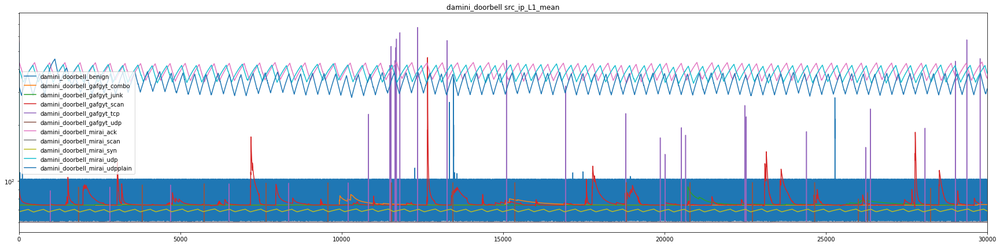

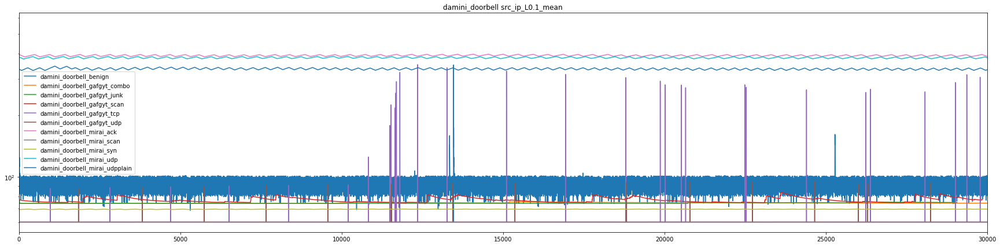

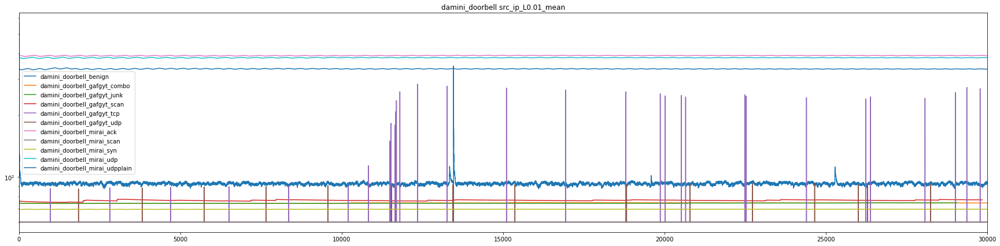

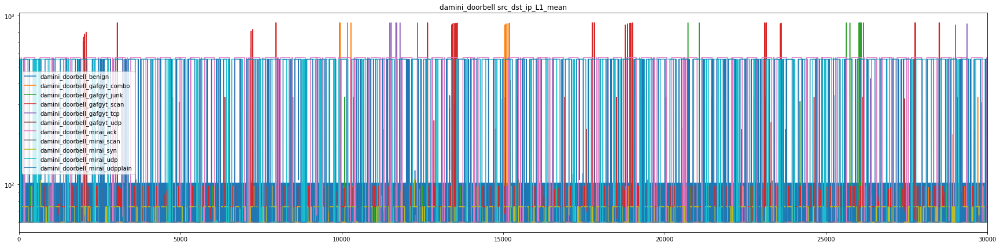

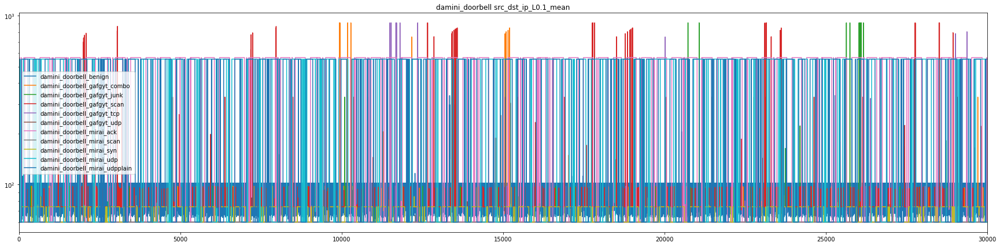

...

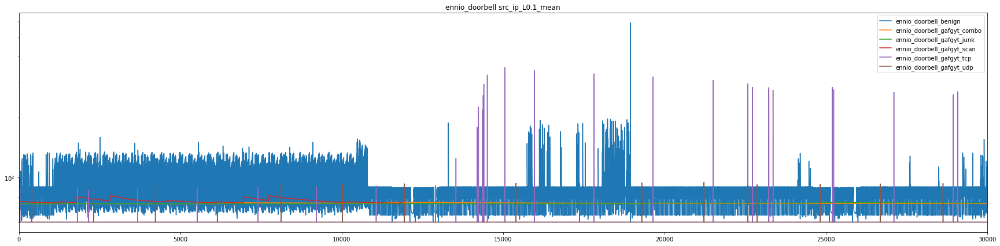

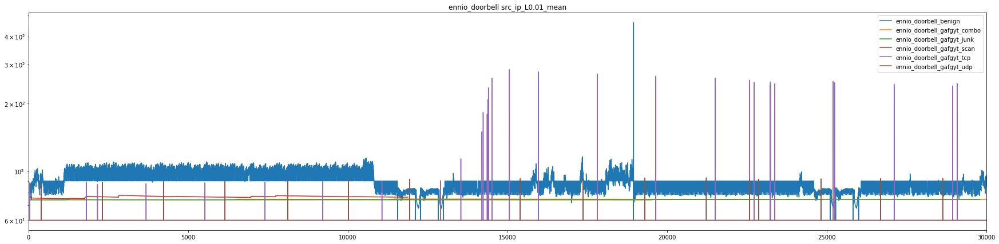

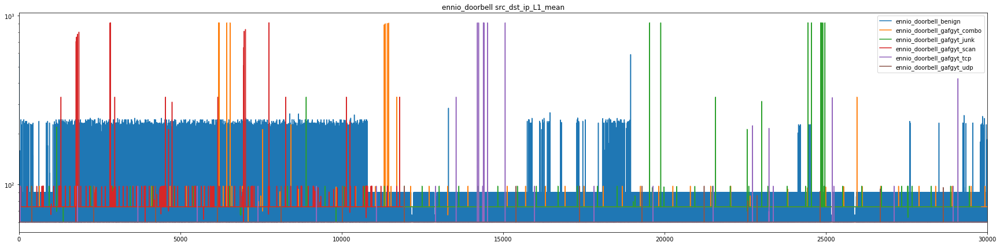

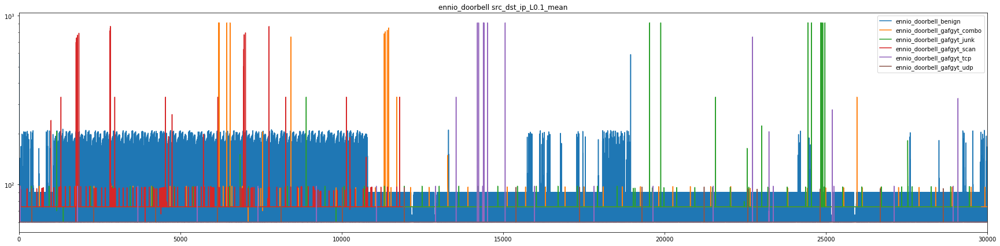

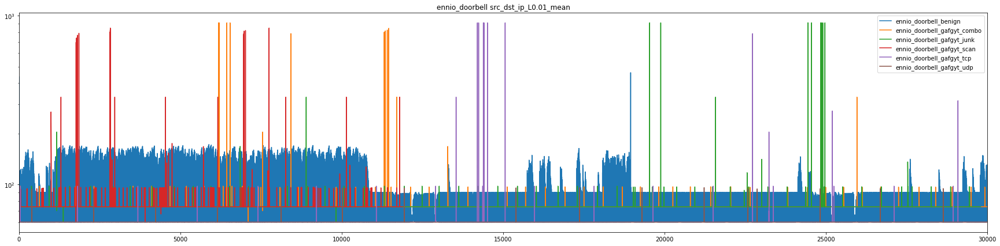

C:\Users\omalkai\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\scale.py:111: RuntimeWarning: invalid value encountered in less_equal
  out[a <= 0] = -1000


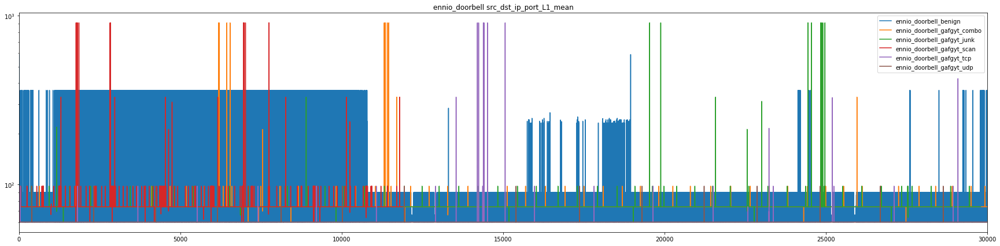

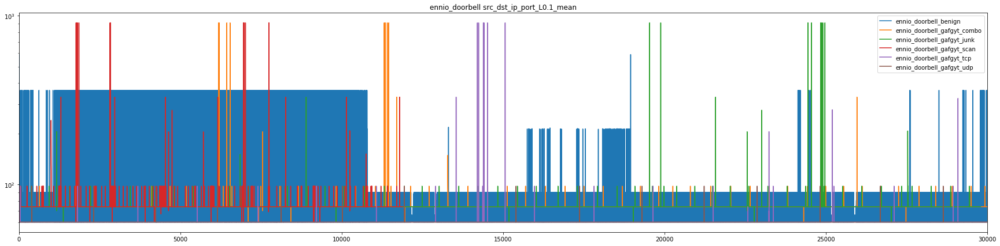

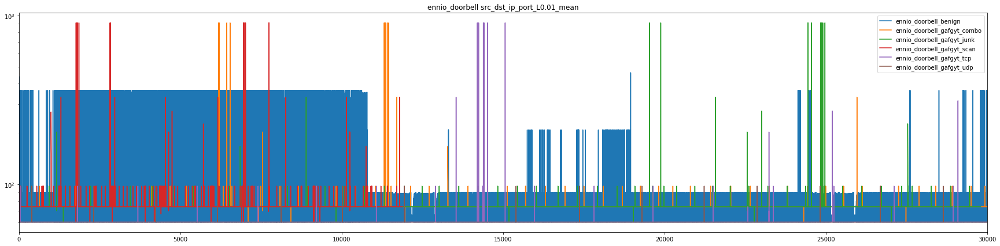

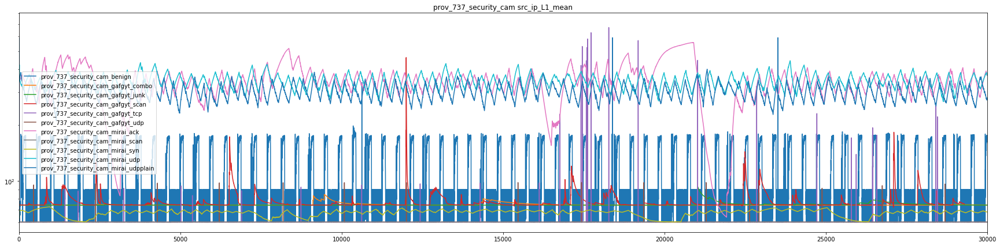

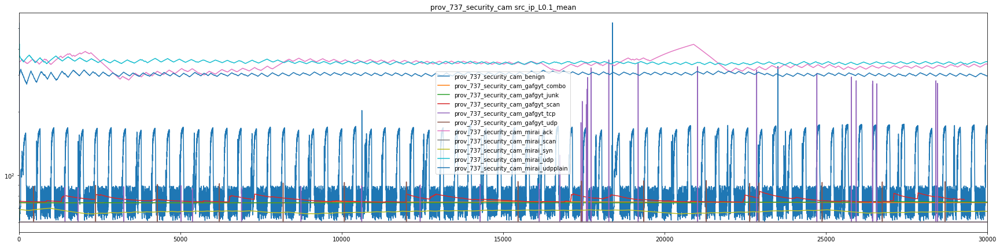

...

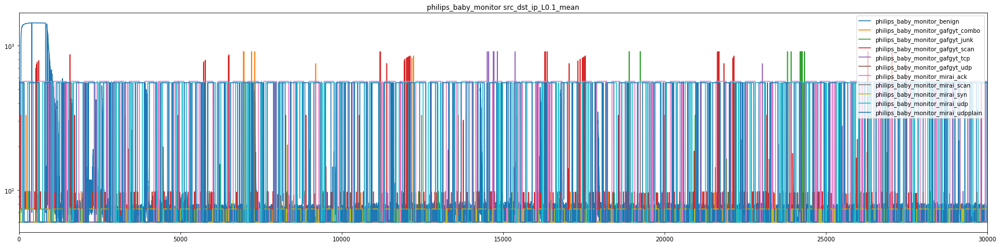

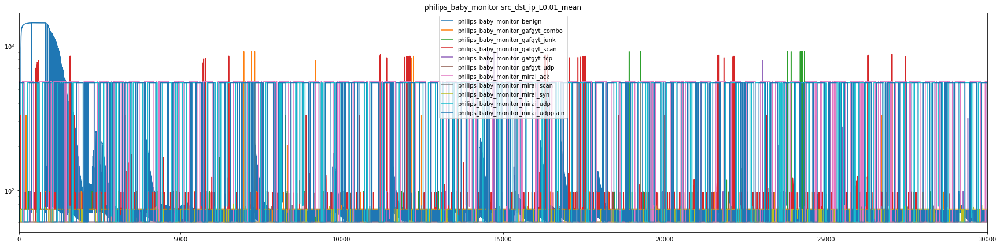

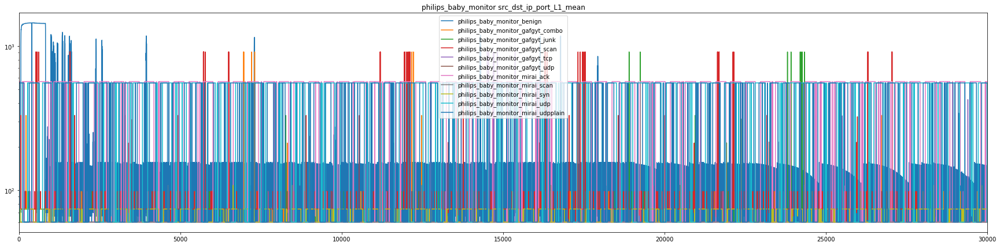

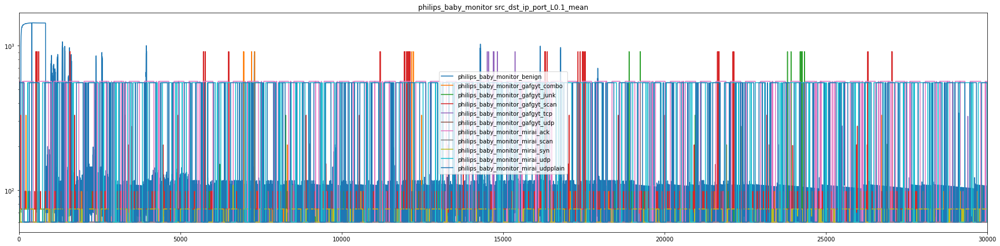

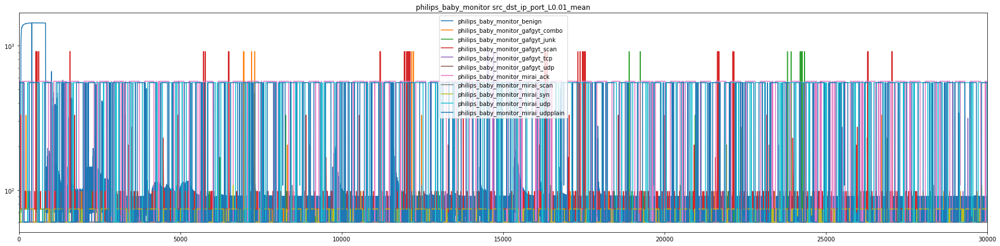

In [37]:
# We are going to explore windows of at least 1.5 seconds, the rest are too frequent.
mean_cols = [src_ip_L1_mean, src_ip_L0_1_mean, src_ip_L0_01_mean,
             src_dst_ip_L1_mean, src_dst_ip_L0_1_mean, src_dst_ip_L0_01_mean,
             src_dst_ip_port_L1_mean, src_dst_ip_port_L0_1_mean, src_dst_ip_port_L0_01_mean]
for dfs, iot_name in dfs_per_iot:
    for col in mean_cols:
        for df, df_name in dfs:
            df[col].plot(figsize=(30, 7), title=iot_name + " " + col, label=df_name, legend=True, logy=True, xlim=(0, 30000))
        plt.show()


### Verification Of Research Assumptions
1. IoT devices of the same type (doorbell, security camera, etc.) should share the same normal behavior.
2. IoT devices should present seasonality in their behaviour.

In order to verify assumption 1, I will check the correlation between the features (benign) of IoT devices, I expect to see high correlation where the IoTs are from the same type and lower correlation in others.
In order to verify assumption 2, I will plot some features where seasonality is present.

#### Benign Features Correlation Of Doorbell IoT
We have two doorbells in our dataset:
1. Danmini Doorbell
2. Ennio_Doorbell

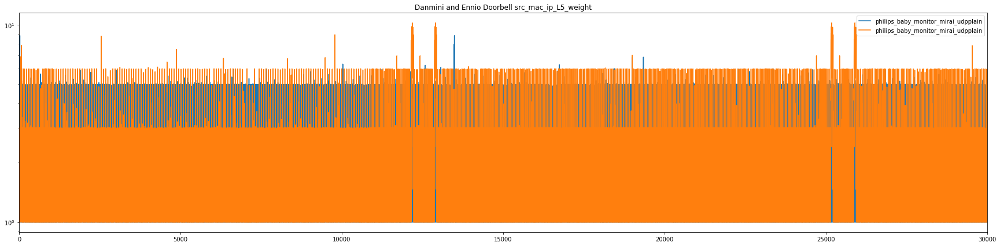

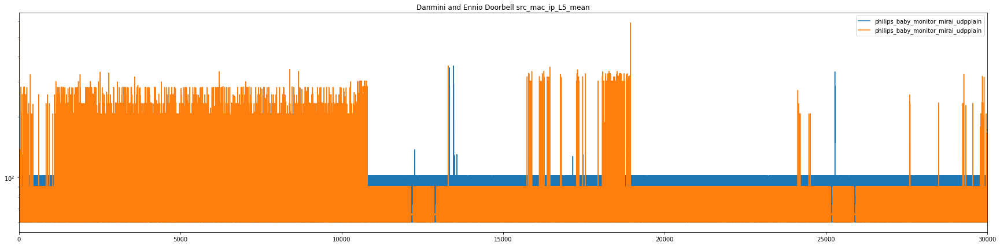

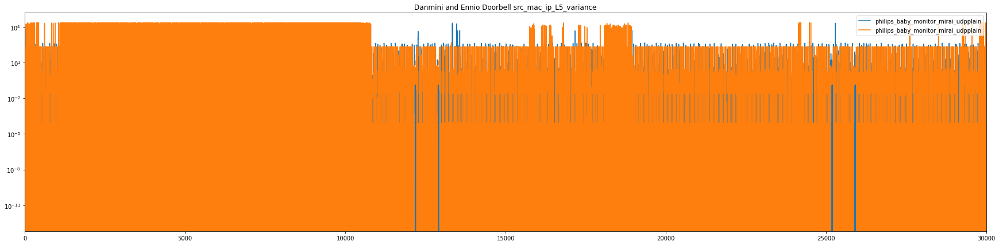

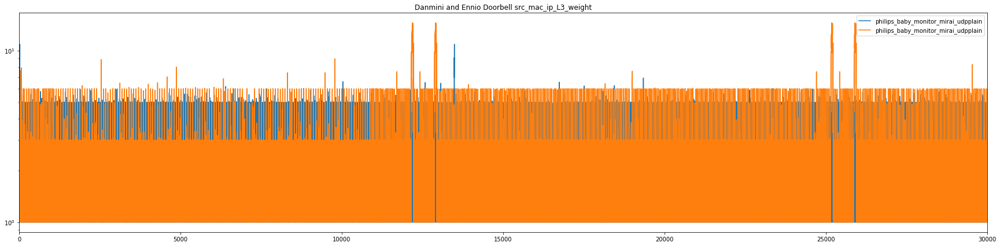

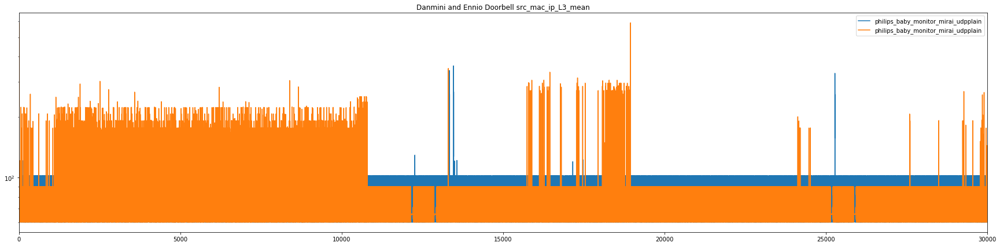

...

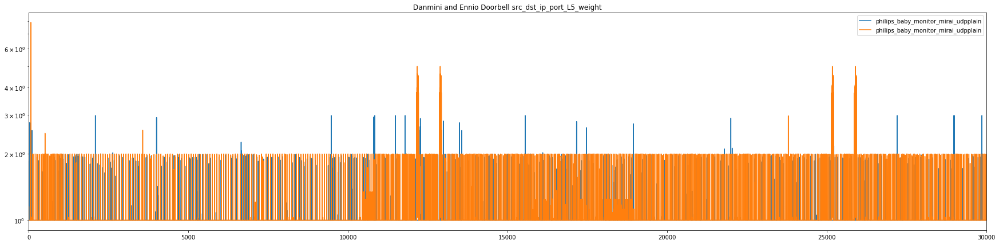

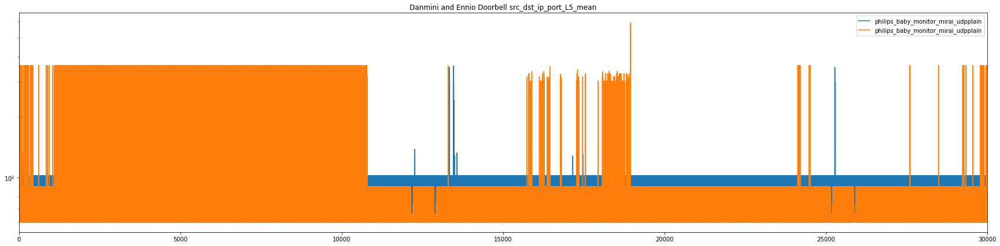

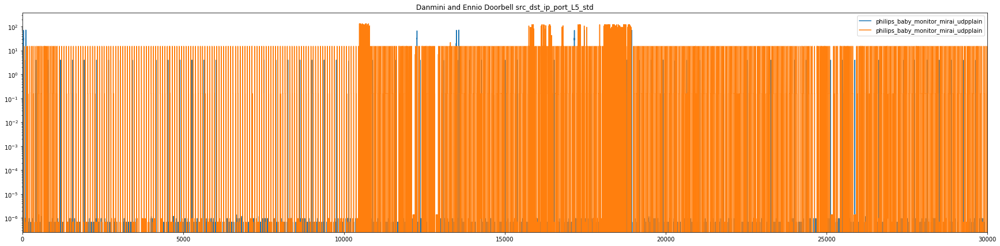

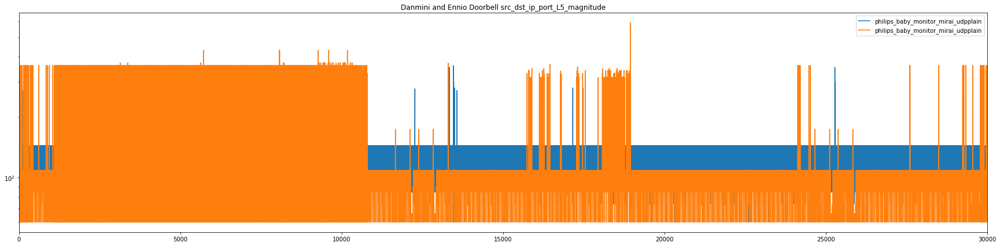

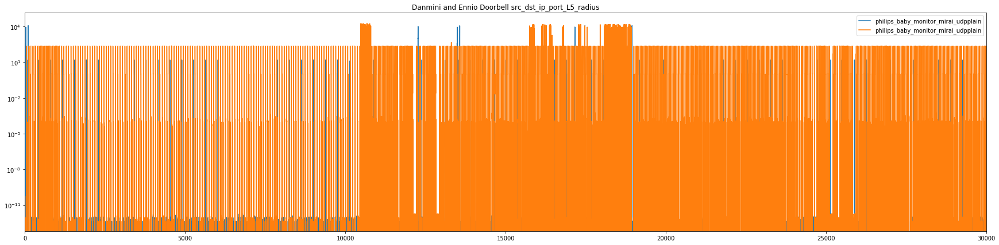

C:\Users\omalkai\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\ticker.py:1099: RuntimeWarning: divide by zero encountered in double_scalars
  coeff = np.round(x / b ** exponent)


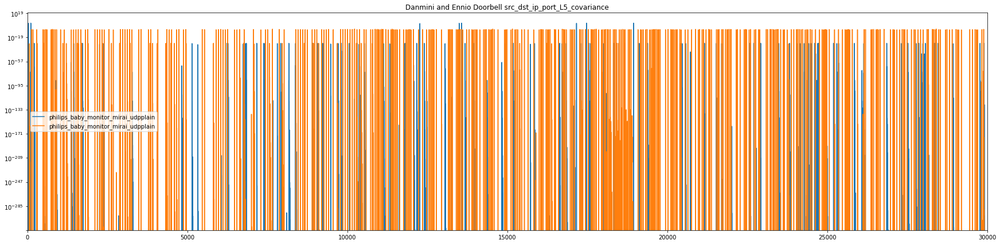

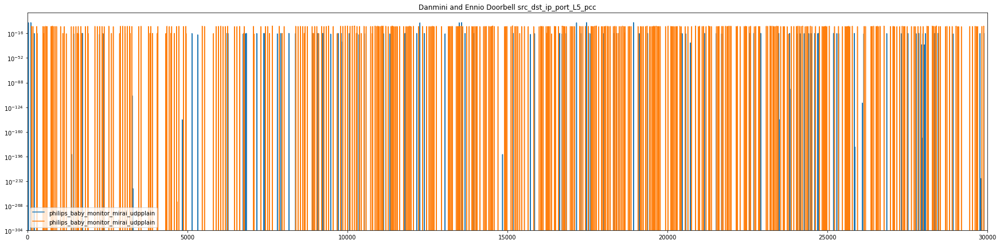

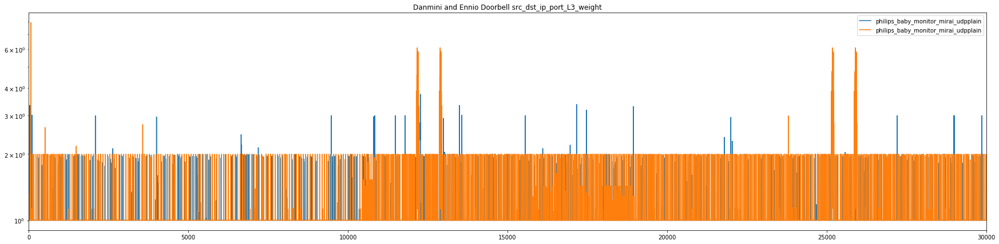

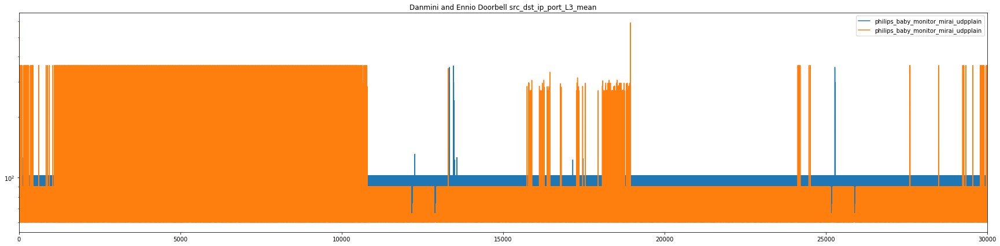

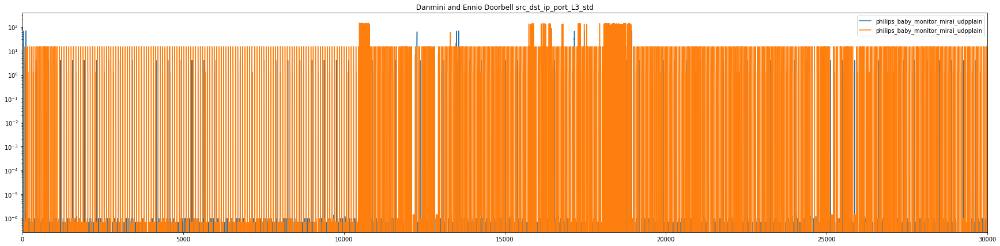

...

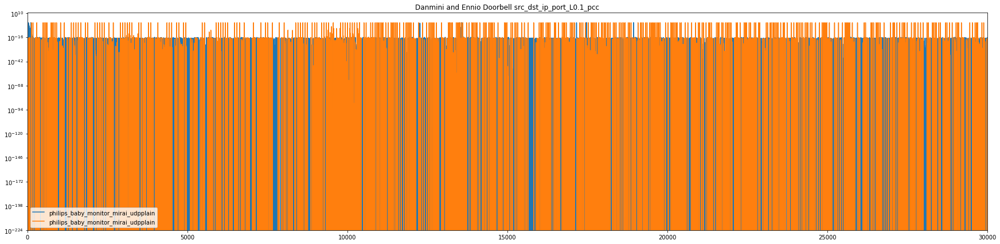

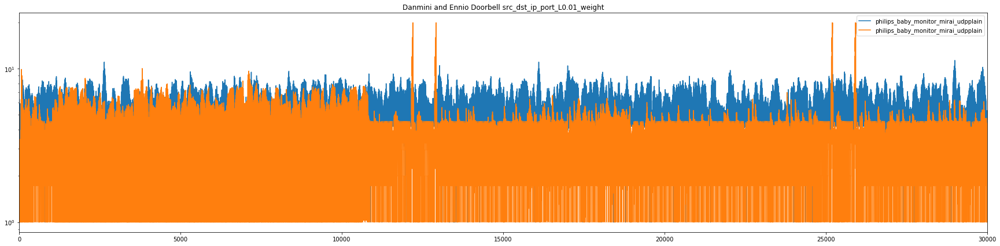

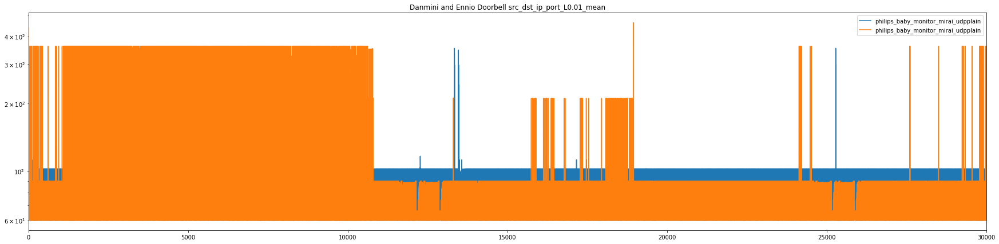

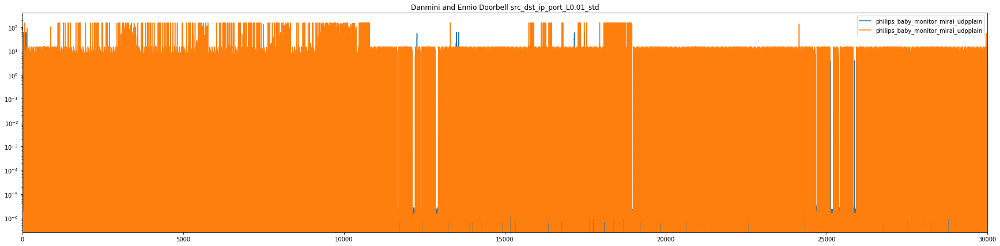

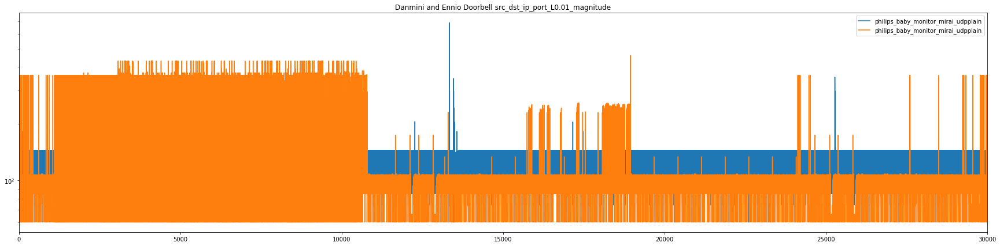

KeyboardInterrupt: 

In [51]:
for col in df_damini_doorbell_benign.columns:
    for df in [df_damini_doorbell_benign, df_ennio_doorbell_benign]:
        df[col].plot(figsize=(30, 7), title="Danmini and Ennio Doorbell " + col, label=df_name, legend=True, logy=True, xlim=(0, 30000))
    plt.show()

In [49]:
df_damini_doorbell_benign.diff().corrwith(df_ennio_doorbell_benign.diff()).describe()

count    115.000000
mean       0.000978
std        0.010033
min       -0.065521
25%       -0.000008
50%        0.002174
75%        0.005805
max        0.034150
dtype: float64

#### Benign Features Correlation Of Security Camera IoT
We have four security cameras in our dataset:
1. Provision PT_737E Security Camera
2. Provision PT_838 Security Camera
3. SimpleHome XCS7 1002 WHT Security Camera
4. SimpleHome XCS7 1003 WHT Security Camera

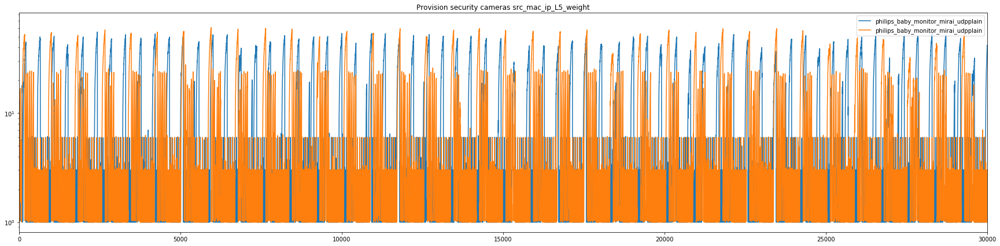

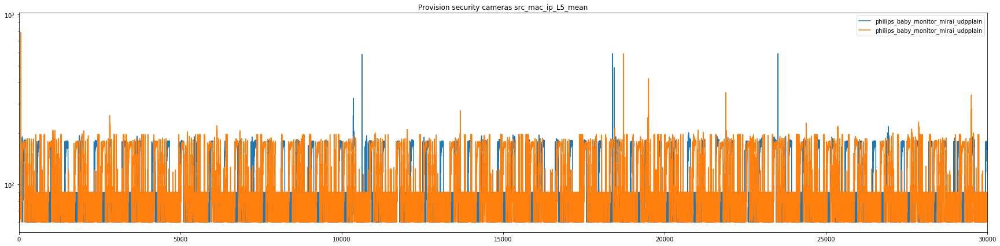

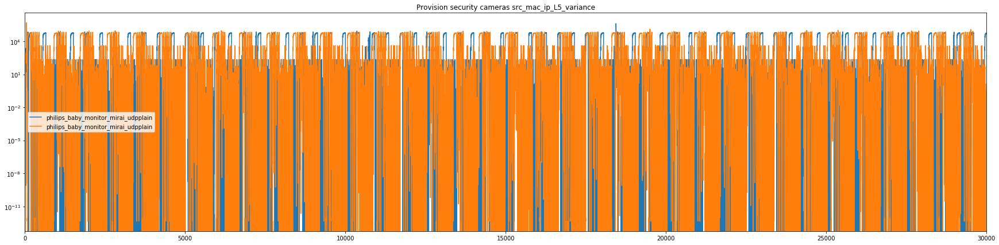

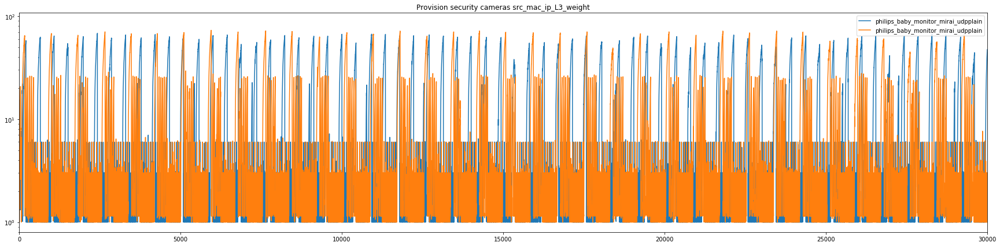

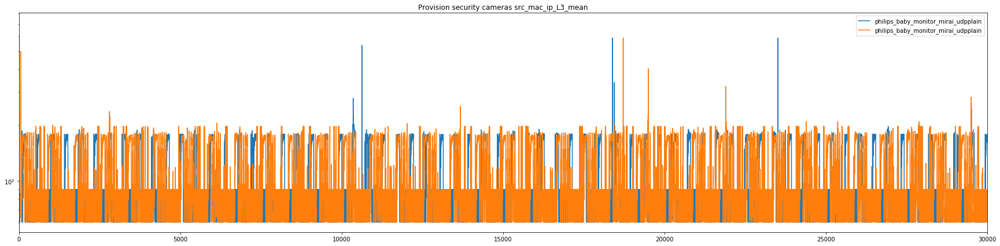

...

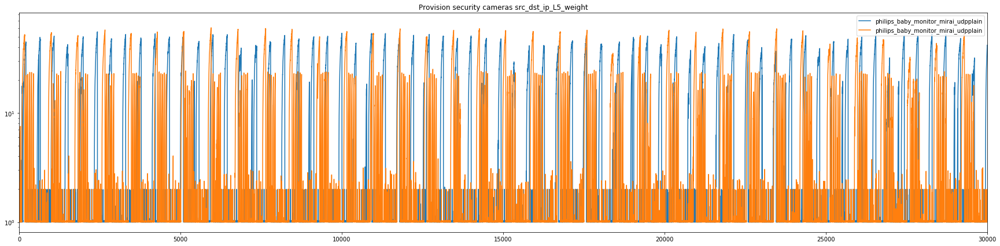

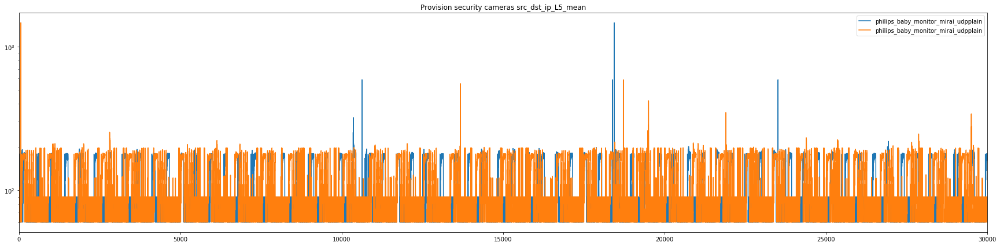

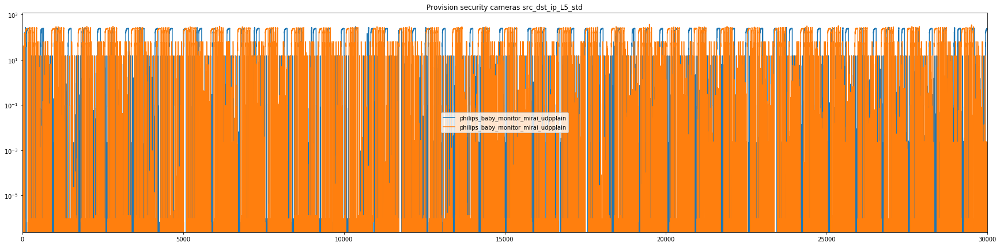

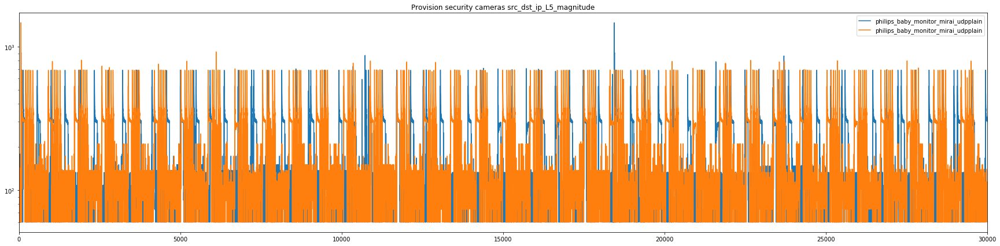

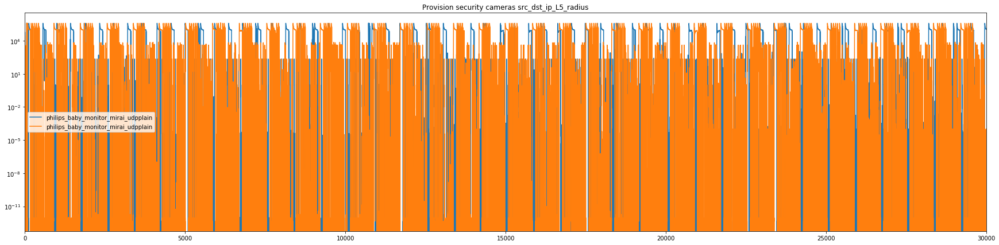

C:\Users\omalkai\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\ticker.py:1099: RuntimeWarning: divide by zero encountered in double_scalars
  coeff = np.round(x / b ** exponent)


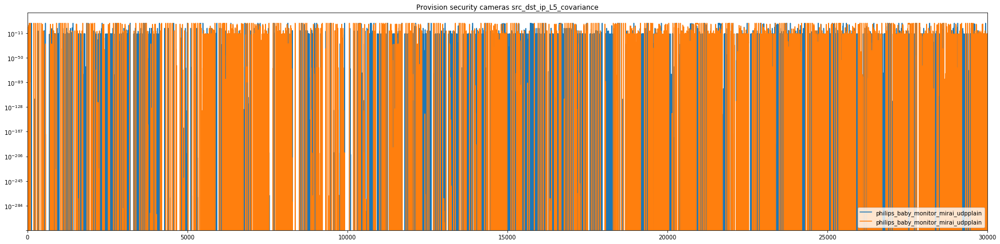

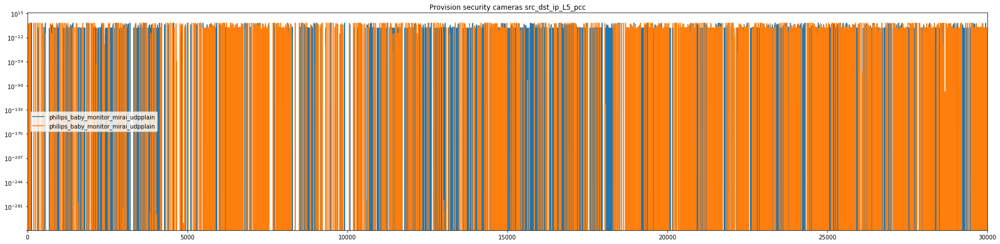

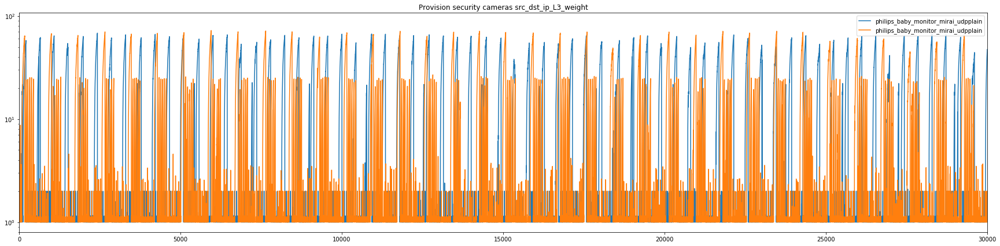

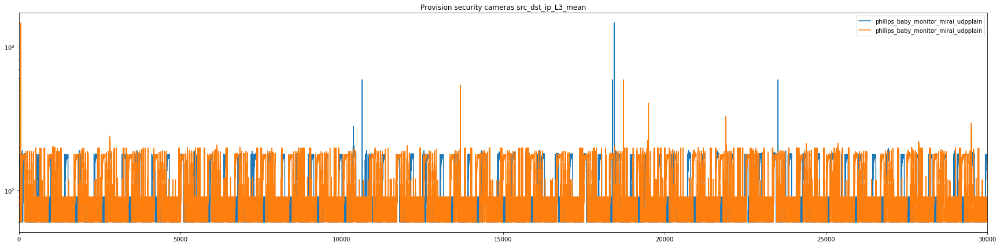

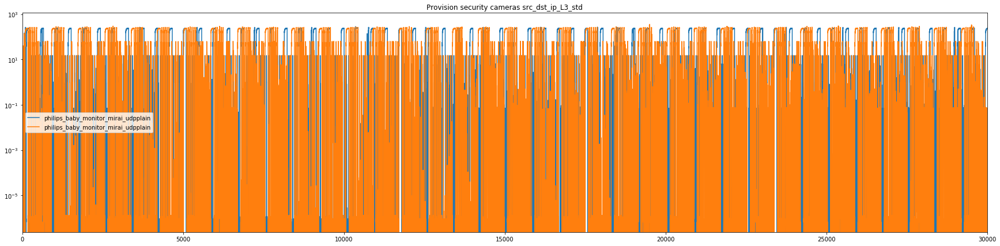

...

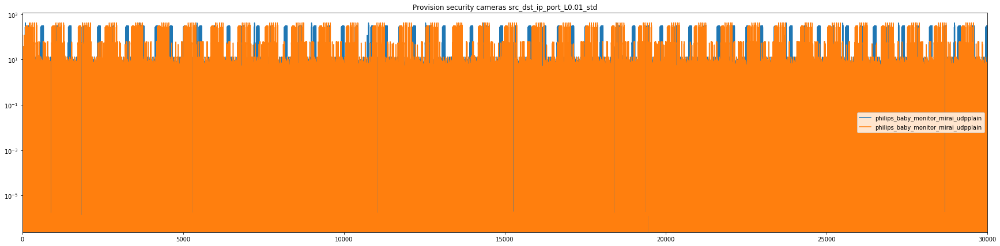

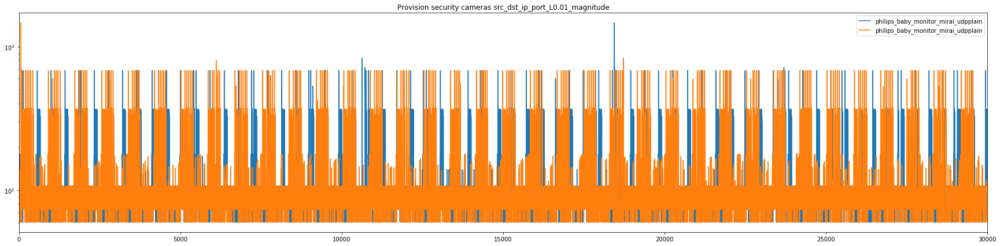

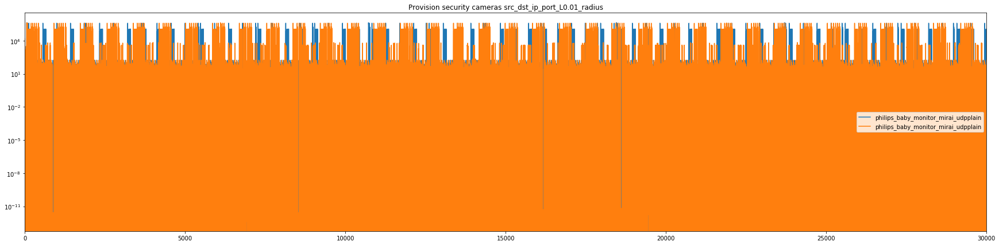

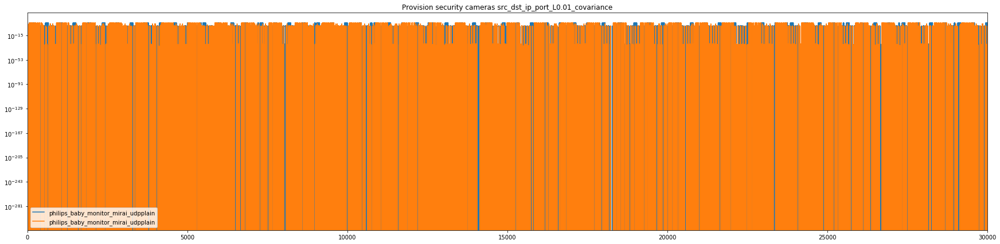

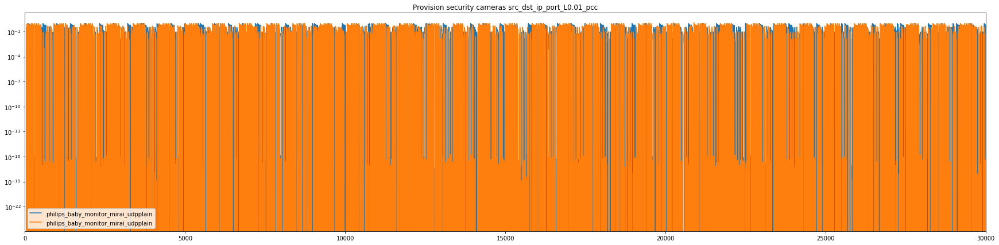

In [52]:
for col in df_prov_737_security_cam_benign.columns:
    for df in [df_prov_737_security_cam_benign, df_prov_838_security_cam_benign]:
        df[col].plot(figsize=(30, 7), title="Provision security cameras " + col, label=df_name, legend=True, logy=True, xlim=(0, 30000))
    plt.show()

In [48]:
df_prov_737_security_cam_benign.diff().corrwith(df_prov_838_security_cam_benign.diff()).describe()

count    115.000000
mean       0.006504
std        0.038412
min       -0.018244
25%       -0.004209
50%       -0.001079
75%        0.002646
max        0.286854
dtype: float64

In [47]:
df_sh_1002_security_cam_benign.diff().corrwith(df_sh_1003_security_cam_benign.diff()).describe()

count    115.000000
mean      -0.000414
std        0.012073
min       -0.055941
25%       -0.001908
50%        0.001771
75%        0.006567
max        0.019012
dtype: float64